# DSCI 100 Group Project -- Classifying an Email as Spam or Not Spam 📧

## Developed by Aadi Kanwar, Stella Williams, Satvika Suresha, and Julian Piezas (Group 21)

## Introduction

Emails can contain viruses which harm one's computer system and their identity [(CISA, 2023)]("https://www.cisa.gov/news-events/news/virus-basics"). These "malicious" emails are often categorized as spam, whereas "benevolent" emails are categorized as "not-spam". Our group looks to explore this binary classification of email through the Spambase Dataset [(UCI ML Repo, 1999)]("https://archive.ics.uci.edu/dataset/94/spambase"). This dataset contains many variables regarding the frequency of strings in the emails, which can be used to classify these emails. Our predictive question is: "Can we use some of the features (namely character frequencies and length of sequences of capital letters) provided to us to predict whether a future email (unknown classification) is spam or not spam?". 

Word Count: 101 Words

## Preliminary Exploratory Data Analysis (Method)

### Reading the dataset into R from the web (this data is raw, next step is cleaning!)

Let's begin our analysis and read in our data from the web!

Word Count: 12 Words

In [5]:
library(tidyverse, warn.conflicts = FALSE)  # loading the tidyverse package for reading our data 
url1 <- "https://raw.githubusercontent.com/aadikanwar/DSCI100_group_project/main/spambase.data"  # URL for the raw dataset, taken from the uploaded data set from our GitHub repo
spam_df <- read_csv(url1, col_names = FALSE, show_col_types = FALSE) #reading the file into the notebook 
head(spam_df, show_col_types = FALSE)

# this is a representation of the RAW data used for this project, we will clean in the upcoming cell 


X1,X2,X3,X4,X5,X6,X7,X8,X9,X10,⋯,X49,X50,X51,X52,X53,X54,X55,X56,X57,X58
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0.00,0.64,0.64,0,0.32,0.00,0.00,0.00,0.00,0.00,⋯,0.00,0.000,0,0.778,0.000,0.000,3.756,61,278,1
0.21,0.28,0.50,0,0.14,0.28,0.21,0.07,0.00,0.94,⋯,0.00,0.132,0,0.372,0.180,0.048,5.114,101,1028,1
0.06,0.00,0.71,0,1.23,0.19,0.19,0.12,0.64,0.25,⋯,0.01,0.143,0,0.276,0.184,0.010,9.821,485,2259,1
0.00,0.00,0.00,0,0.63,0.00,0.31,0.63,0.31,0.63,⋯,0.00,0.137,0,0.137,0.000,0.000,3.537,40,191,1
0.00,0.00,0.00,0,0.63,0.00,0.31,0.63,0.31,0.63,⋯,0.00,0.135,0,0.135,0.000,0.000,3.537,40,191,1
0.00,0.00,0.00,0,1.85,0.00,0.00,1.85,0.00,0.00,⋯,0.00,0.223,0,0.000,0.000,0.000,3.000,15,54,1


As we see, the data does not seem to have columns, and there seems to be a bit too many predictors. We also need to assign our last column to a classification factor, to run our KNN classification properly. Let's clean the data and choose predictors that are relevant to our analysis! 

Word Count: 52 Words

### Cleaning and Wrangling the Data 

In [6]:
set.seed(200)
## we can pre-select some columns instead of naming all 58 columns, as the column names are described in the dataset location (DOI)
spam_data <- read_csv(url1, col_names = FALSE, show_col_types = FALSE) |>
    select(49: 55, X58) |>
    rename("char_freq_semicolon" = "X49", "char_freq_paren" = "X50", "char_freq_brack" = "X51", "char_freq_excl" = "X52", "char_freq_mon" = "X53", "char_freq_hash" = "X54", "capital_run_length_average" = "X55", "spam_or_not_spam" = "X58") ## renaming the column names to proper names
    
spam_data <- spam_data |>
    mutate(spam_or_not_spam = as_factor(spam_or_not_spam))

spam_data <- spam_data |>
    mutate(spam_or_not_spam = fct_recode(spam_or_not_spam, "spam" = "1", "not_spam" = "0"))

head(spam_data, show_col_types = FALSE)
tail(spam_data, show_col_types = FALSE)


char_freq_semicolon,char_freq_paren,char_freq_brack,char_freq_excl,char_freq_mon,char_freq_hash,capital_run_length_average,spam_or_not_spam
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
0.00,0.000,0,0.778,0.000,0.000,3.756,spam
0.00,0.132,0,0.372,0.180,0.048,5.114,spam
0.01,0.143,0,0.276,0.184,0.010,9.821,spam
0.00,0.137,0,0.137,0.000,0.000,3.537,spam
0.00,0.135,0,0.135,0.000,0.000,3.537,spam
0.00,0.223,0,0.000,0.000,0.000,3.000,spam


char_freq_semicolon,char_freq_paren,char_freq_brack,char_freq_excl,char_freq_mon,char_freq_hash,capital_run_length_average,spam_or_not_spam
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
0.000,0.000,0,0.000,0,0,1.000,not_spam
0.000,0.232,0,0.000,0,0,1.142,not_spam
0.000,0.000,0,0.353,0,0,1.555,not_spam
0.102,0.718,0,0.000,0,0,1.404,not_spam
0.000,0.057,0,0.000,0,0,1.147,not_spam
0.000,0.000,0,0.125,0,0,1.250,not_spam


Now the data is clean and wrangled. Each row is a singular observation, each column is a singular variable, and each cell contains a singular value, and so this data is tidy. Names were added to the columns, the class column was converted to a factor and recoded to "spam" or "not_spam" from 1 and 0. We can already begin to see that lower character frequencies lead to an email classification of "not_spam: ... we can verify this soon with our analysis. 

It is also important to consider why we have chosen the predictors that we have chosen for this assignment, as we have reduced the number of columns within the dataset substantially. According to the UCI repository from which this dataset was chosen, all of the other predictors included within the dataset were regarding word frequencies in emails. However, we felt that when you consider a spam email carefully, it is more likely for there to be different characters that differentiate between a spam or regular email. For example, if you were encountered with an email with a message that reads "@#!@$!$(&(SSSD&#(", you would likely consider it to be a spam email; perhaps more likely than an email that reads a properly grammatical sentence. However, it is likely that removal of so many rows will cause the classifier to be biased towards character frequency as opposed to word frequency. We will keep this in mind when conducting our analysis, and shall bring it up more carefully in the discussion. 

Word Count: 249 Words

### Creating Summary Tables using Training Data

#### Initializing Required Packages for Analysis 

Below we initialize some libraries to ensure that the tables can be generated and our KNN model can run. 

In [7]:
set.seed(200) # to fix the randomization to one randomization
library(tidymodels, warn.conflicts = FALSE) # for training and testing split 
library(dbplyr, warn.conflicts = FALSE) # for the rename function 
install.packages("kknn", quiet = TRUE)
install.packages("cowplot", quiet = TRUE)
library(cowplot, warn.conflicts = FALSE)
library(repr, warn.conflicts = FALSE)
install.packages("shiny")

── Attaching packages ────────────────────────────────────── tidymodels 1.0.0 ──

✔ broom        1.0.2     ✔ rsample      1.1.1
✔ dials        1.1.0     ✔ tune         1.0.1
✔ infer        1.0.4     ✔ workflows    1.1.2
✔ modeldata    1.0.1     ✔ workflowsets 1.0.0
✔ parsnip      1.0.3     ✔ yardstick    1.1.0
✔ recipes      1.0.4     

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr::discard()
✖ dplyr::filter()   masks stats::filter()
✖ recipes::fixed()  masks stringr::fixed()
✖ dplyr::lag()      masks stats::lag()
✖ yardstick::spec() masks readr::spec()
✖ recipes::step()   masks stats::step()
• Use tidymodels_prefer() to resolve common conflicts.

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



Let us now create some tables that will be of importance in creating a new observation and considering the distribution of the data!

Word Count: 23 Words

#### Table 1: Determining the Mean of All Predictor Variables, and Count of NAs in Training Data

In [8]:
spam_split <- initial_split(spam_data, prop = 0.6, strata = spam_or_not_spam)  #splitting the data into training and testing data
spam_training <- training(spam_split)
spam_testing <- testing(spam_split)

summary_table_1 <- spam_training |>
    select(-spam_or_not_spam) |>              # computes the averages of variables in data, along with the number of NA's in data
    map_df(mean, na.rm = TRUE) |>
    mutate(num_of_na = sum(is.na(spam_training)))

summary_table_1 <- summary_table_1 |>  # renaming the names in the aforementioned table 
    rename("mean_;_freq" = "char_freq_semicolon", "mean_(_freq" = "char_freq_paren", "mean_[_freq" = "char_freq_brack", "mean_!_freq" = "char_freq_excl", "mean_$_freq" = "char_freq_mon", "mean_#_freq" = "char_freq_hash", "mean_capital_run" = "capital_run_length_average") 

summary_table_1


## it is important to recognize that scaling and centering WILL BE DONE after the proposal and during the actual classification

mean_;_freq,mean_(_freq,mean_[_freq,mean_!_freq,mean_$_freq,mean_#_freq,mean_capital_run,num_of_na
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
0.04564625,0.1422573,0.01715839,0.288884,0.0764875,0.04550127,4.945219,0


#### Table 2: Determining the Dimensions of Rows and Columns in Training Data

In [9]:
summary_table_2 <- tibble(dim(spam_training)) |>  
    rename("dim_of_training_rows_then_cols" = "dim(spam_training)") #dimensions of the training data

summary_table_2

dim_of_training_rows_then_cols
<int>
2759
8


#### Table 3: Determining the Dimensions of Rows and Columns in Testing Data

In [10]:
summary_table_3 <- tibble(dim(spam_testing)) |>
    rename("dim_of_testing_rows_then_cols" = "dim(spam_testing)")   #dimensions of the testing data

summary_table_3

dim_of_testing_rows_then_cols
<int>
1842
8


#### Table 4: Determining Count of Classes, Along with Percentage of Each Class in Testing Data

In [11]:
number_of_obs <- nrow(spam_testing)

summary_table_4 <- spam_testing |>  ## showing the percentage distribution of the classes spam and not spam
    group_by(spam_or_not_spam) |>   
    summarize(count = n(), percentage = n()/ number_of_obs * 100)

summary_table_4 <- summary_table_4 |>
    rename("classes" = "spam_or_not_spam")
summary_table_4


classes,count,percentage
<fct>,<int>,<dbl>
not_spam,1116,60.58632
spam,726,39.41368


#### Table 5: Determining Standard Deviation of Predictors in Training Data

In [12]:
summary_table_5 <- spam_training |>
    select(-spam_or_not_spam) |>
    map_df(sd, na.rm = TRUE) 

summary_table_5 <- summary_table_5 |>
    rename("sd_;_freq" = "char_freq_semicolon", "sd_(_freq" = "char_freq_paren", "sd_[_freq" = "char_freq_brack", "sd_!_freq" = "char_freq_excl", "sd_$_freq" = "char_freq_mon", "sd_#_freq" = "char_freq_hash", "sd_capital_run" = "capital_run_length_average")

summary_table_5

sd_;_freq,sd_(_freq,sd_[_freq,sd_!_freq,sd_$_freq,sd_#_freq,sd_capital_run
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0.2940466,0.2820605,0.1148197,0.9660054,0.2401114,0.4367491,25.12168


#### Table 6: Determining Median of Predictors in Training Data

In [13]:
summary_table_6 <- spam_training |>
    select(-spam_or_not_spam) |>
    map_df(median, na.rm = TRUE) 

summary_table_6 <- summary_table_6 |>
    rename("med_;_freq" = "char_freq_semicolon", "med_(_freq" = "char_freq_paren", "med_[_freq" = "char_freq_brack", "med_!_freq" = "char_freq_excl", "med_$_freq" = "char_freq_mon", "med_#_freq" = "char_freq_hash", "med_capital_run" = "capital_run_length_average")

summary_table_6

med_;_freq,med_(_freq,med_[_freq,med_!_freq,med_$_freq,med_#_freq,med_capital_run
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0,0.066,0,0,0,0,2.306


### Creating Important Plots Comparing Predictors Versus Semicolon Frequency, Colored by Class

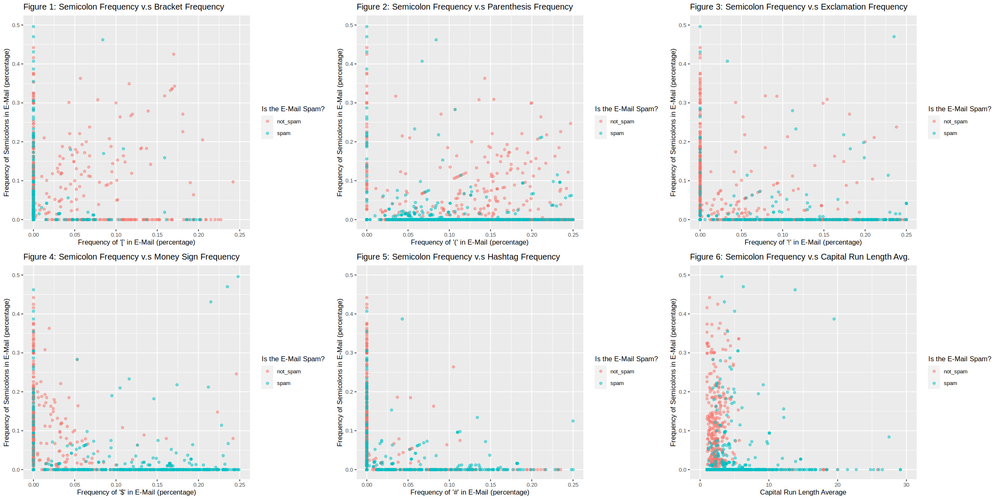

In [14]:
library(repr) # for setting the height and width of the plots 

options(repr.plot.width = 20, repr.plot.height = 10)

spam_plot1 <- spam_training |>
    ggplot(aes(x = char_freq_brack, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    labs(x = "Frequency of '[' in E-Mail (percentage)", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 0.25)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 1: Semicolon Frequency v.s Bracket Frequency")

spam_plot2 <- spam_training |>
    ggplot(aes(x = char_freq_paren, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    labs(x = "Frequency of '(' in E-Mail (percentage)", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 0.25)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 2: Semicolon Frequency v.s Parenthesis Frequency")

spam_plot3 <- spam_training |>
    ggplot(aes(x = char_freq_excl, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    labs(x = "Frequency of '!' in E-Mail (percentage)", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 0.25)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 3: Semicolon Frequency v.s Exclamation Frequency")

spam_plot4 <- spam_training |>
    ggplot(aes(x = char_freq_mon, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    labs(x = "Frequency of '$' in E-Mail (percentage)", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 0.25)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 4: Semicolon Frequency v.s Money Sign Frequency")

spam_plot5 <- spam_training |>
    ggplot(aes(x = char_freq_hash, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    labs(x = "Frequency of '#' in E-Mail (percentage)", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 0.25)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 5: Semicolon Frequency v.s Hashtag Frequency")

spam_plot6 <- spam_training |>
    ggplot(aes(x = capital_run_length_average, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    labs(x = "Capital Run Length Average", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 30)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 6: Semicolon Frequency v.s Capital Run Length Avg.")


suppressWarnings(plot_grid(spam_plot1, spam_plot2, spam_plot3, spam_plot4, spam_plot5, spam_plot6))

As we see here, it is often the case that higher frequency of random characters in emails lead to a higher chance of the emails being spam. We can see this in Figures 2, 3, 4, 5 and 6, but Figure 1 seems to be slightly different in that a higher frequency of hard brackets does not necessarily lead to an email classification of "spam". We can consider why this is, and how this can affect a new observation that we make at the end of the report, in its classification of "spam" or "not spam". 

We can also notice in Figure 6 that there is a bit more variance in the x-variable; we still see a trend of "as you increase 'x', your email is more likely to be classified as 'spam'", but we can notice that there are a significant number of points present at the '10' mark on the x-axis, which are not present in the other Figures and are therefore not shown in the graphs. We can consider this mathematically through standard deviation as the standard deviation is the square root of variance. We see that as the variance increases, so does standard deviation, and can verify this via Table 5. 

We see in Table 5 that the standard deviation for the capital run length average is around 25, which is substantially larger than the other standard deviations that lie around 0.5. This gives us insight into the fact that there should be some scaling so the capital run length average does not dominate our classification, and also that we need to have a higher capital run length average value than the other values when creating our new observation. 

Word Count: 284 Words

### How will we conduct our analysis? What variables will we consider?

We will conduct our analysis via KNN classification, as we are considering a binary classification of "spam" or "not spam" emails, which are categorical classifications. We will consider the result of our model through accuracy, and also precision/recall, to determine how our model treated positives and negatives. The raw dataset contained 58 features, but for the purpose of this project we consider 7: frequency of characters such as hard and soft brackets, semicolons, money symbols, exclamation points, and hash signs (**all as percentages**), as well as the average length of uninterrupted capital letters (i.e "AAABSsdA") has a length of 5 uninterrupted capitals. To choose these we took into account articles such as [(Forbes, 2010)]("https://www.forbes.com/sites/firewall/2010/03/17/the-most-common-words-in-spam-email/?sh=5f23e8df7d80"), which consider words that are most frequent in spam emails. These words often contain the aforementioned symbols (brackets, exclamations, etc.), and so we believed that it would make for a good classification to use these as our predictors.

Word Count: 152 Words

### How will we visualize our results?

We will visualize our results via multiple plots as shown above, considering all of the different features and colored by the class of "spam" or "not_spam". We can then create background fields of the colours of spam or not spam, to indicate how much of the graph would have been classified as spam and how much would have been classified as not spam, considering an arbitrary unknown observation. For our accuracy we will look to plot the K values versus our accuracy to see which K yields the best accuracy. 

Word Count: 90 Words 

## Expected Outcomes and Significance

### What do we expect to find?

We expect that emails with high frequency of the listed characters and long sequences of uninterrupted capitals will be classified as spam emails, and low frequency and sequences will be classified as "not spam". 

Word Count: 34 Words

### What impact could such findings have?

The findings in this project could aid data scientists to change their pre-existing classifiers for spam emails, as there may be some results that do not align with their hypothesis'.

Word Count: 30 Words

### What future questions could this lead to?

This project could lead to questions about how emails should/should not be classified as spam; if high frequency characters do **not** lead to spam email, then data scientists may focus on low frequency characters, and vice versa. 

Word Count: 38 Words

## Conducting Our Analysis (Method & Results)

### Creating the Recipe, Tuning Model, and a measure of Model Results using KNN

Let us commence with the real analysis of our KNN model. We begin with creating a cross validation fold of K values for our model, to see which K value in our model yields the most accurate classification. We then establish a recipe for our model, which will be used extensively throughout the report. Then we create a tuning of the model (knn_tune). After that we collect our metrics in a workflow and create a tibble for just the accuracies per K value which can be used to plot Accuracy versus K to help us determine which K value to use in our KNN model. We choose an arbitrary value of $v$ and $grid$ of 5 and 10 respectively in this circumstance. 

Word Count: 122 Words

In [15]:
set.seed(4321)

spam_vfold <- vfold_cv(spam_training, v = 5, strata = spam_or_not_spam)

spam_recipe <- recipe(spam_or_not_spam ~., data = spam_training) |>
    step_center(all_predictors()) |>
    step_scale(all_predictors())

knn_tune <- nearest_neighbor(weight_func = 'rectangular', neighbors = tune()) |>
    set_engine("kknn") |>
    set_mode("classification") 

knn_results <- workflow() |>
    add_recipe(spam_recipe) |>
    add_model(knn_tune) |>
    tune_grid(resamples = spam_vfold, grid = 10) |>
    collect_metrics()

accuracies <- knn_results |>
    filter(.metric == 'accuracy')


#### Table 7: First Three Rows of Metric Results of Our Classification Model with 14 Different K Values

In [16]:
head(knn_results, n = 3)

neighbors,.metric,.estimator,mean,n,std_err,.config
<int>,<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
2,accuracy,binary,0.8274753,5,0.004050127,Preprocessor1_Model01
2,roc_auc,binary,0.8597166,5,0.004378088,Preprocessor1_Model01
4,accuracy,binary,0.8452454,5,0.004959279,Preprocessor1_Model02


#### Table 8: Last Three Rows of Metric Results of Our Classification Model with 14 Different K Values

In [17]:
tail(knn_results, n = 3)

neighbors,.metric,.estimator,mean,n,std_err,.config
<int>,<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
13,roc_auc,binary,0.8955709,5,0.004900427,Preprocessor1_Model09
14,accuracy,binary,0.8426848,5,0.004730231,Preprocessor1_Model10
14,roc_auc,binary,0.8960509,5,0.005276679,Preprocessor1_Model10


#### Table 9: Demonstrating All Model Accuracy Achieved with Each K Value

In [18]:
accuracies

neighbors,.metric,.estimator,mean,n,std_err,.config
<int>,<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
2,accuracy,binary,0.8274753,5,0.004050127,Preprocessor1_Model01
4,accuracy,binary,0.8452454,5,0.004959279,Preprocessor1_Model02
5,accuracy,binary,0.8463264,5,0.005167634,Preprocessor1_Model03
7,accuracy,binary,0.8481321,5,0.004990750,Preprocessor1_Model04
8,accuracy,binary,0.8481321,5,0.004990750,Preprocessor1_Model05
9,accuracy,binary,0.8430518,5,0.003103136,Preprocessor1_Model06
11,accuracy,binary,0.8455834,5,0.004525259,Preprocessor1_Model07
12,accuracy,binary,0.8455834,5,0.004525259,Preprocessor1_Model08
13,accuracy,binary,0.8423232,5,0.004459979,Preprocessor1_Model09


Now we can see each accuracy of the classifier per each K value that we can use for this model, along with a few other metrics that are not as relevant for the purpose of this report. We can use this tibble to make a plot of our accuracies versus our K values to appropriately determine which K value we should use in our model to yield the highest model accuracy. 

Word Count: 71 Words

### Creating KNN Model with New K Value, and Fitting the Model 

#### Plotting Accuracy Versus K Value to Yield the Best K for Upcoming Analysis

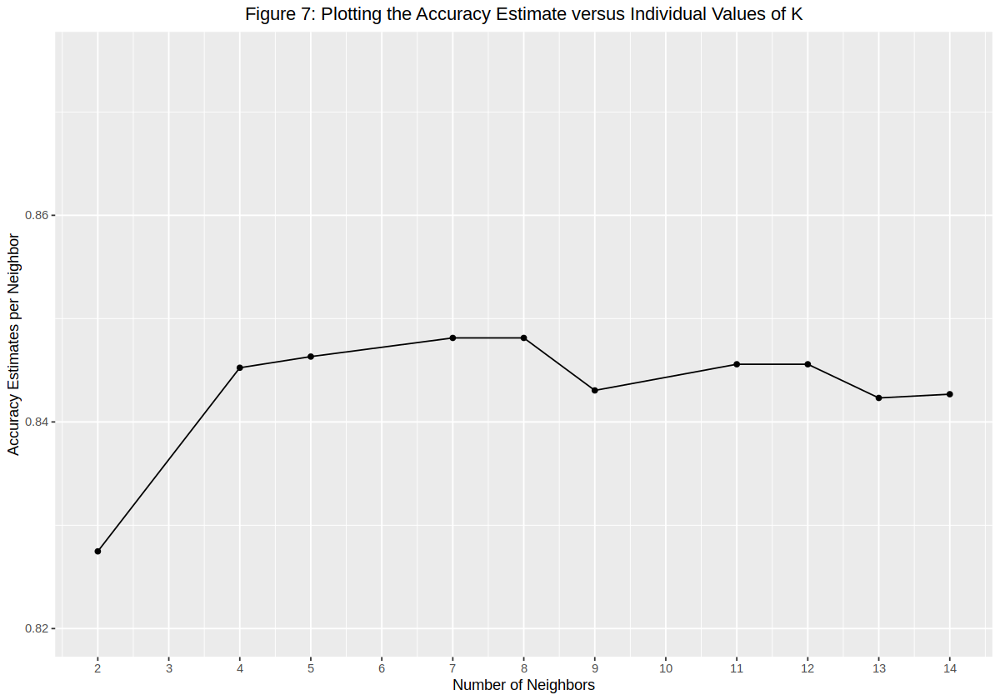

In [19]:
options(repr.plot.width = 10, repr.plot.height = 7)
point1 <- c(7, 0.8481321)

accuracy_vs_k <- ggplot(accuracies, aes(x = neighbors, y = mean)) +
    geom_point() +
    geom_line() +
    labs(x = 'Number of Neighbors', y = 'Accuracy Estimates per Neighbor') +
    scale_x_continuous(breaks = seq(0, 14, by = 1)) +
    scale_y_continuous(limits = c(0.82, 0.875)) +
    ggtitle("Figure 7: Plotting the Accuracy Estimate versus Individual Values of K") +
    theme(plot.title = element_text(hjust = 0.5)) 

accuracy_vs_k

Aha! From Figure 7 we can see that there are two values of K that yield the same (and highest) accuracy. These values are evidently K = 7 and K = 8. So, we can choose one of these values to continue on with our analysis; let us choose K = 7 for this investigation! Using this value, we can continue building our KNN model to actually classify a new observation!

Word Count: 68 Words

#### Creating a Model With our New K Value (K = 7) and Fitting this Model to a Workflow

Using our new K value of 7, we can create a model for our classification algorithm to work on, and we can fit this model along with the preexisting recipe we created using a workflow!

Word Count

In [20]:
knn_spec <- nearest_neighbor(weight_func = 'rectangular', neighbors = 7) |>
    set_engine("kknn") |>
    set_mode("classification") 

spam_fit <- workflow() |>
    add_recipe(spam_recipe) |>
    add_model(knn_spec) |>
    fit(data = spam_training)

spam_fit

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: nearest_neighbor()

── Preprocessor ────────────────────────────────────────────────────────────────
2 Recipe Steps

• step_center()
• step_scale()

── Model ───────────────────────────────────────────────────────────────────────

Call:
kknn::train.kknn(formula = ..y ~ ., data = data, ks = min_rows(7,     data, 5), kernel = ~"rectangular")

Type of response variable: nominal
Minimal misclassification: 0.148967
Best kernel: rectangular
Best k: 7

### Determining Model Accuracy and Implementing a Confusion Matrix

#### Table 10: Determining a Measure of Accuracy for Our Classification Model

In [21]:
spam_test_predictions <- predict(spam_fit, spam_testing) |>
    bind_cols(spam_testing)

spam_prediction_accuracy <- spam_test_predictions |>
    metrics(truth = spam_or_not_spam, estimate = .pred_class) |>
    filter(.metric == "accuracy") |>
    select(-.estimator)

spam_prediction_accuracy



.metric,.estimate
<chr>,<dbl>
accuracy,0.8686211


As shown above, the accuracy for our model came to a value of about $0.87$, which is around $87\%$ accurate! This is not bad, but we would want a higher accuracy if we were actually classifying emails as "spam" or "not spam". For example, what if we were to classify an extremely important email as spam, or what if we classified a spam email as something more benign? Chances are that we would be hurting individuals in this case. Even though we would not be hurting many, the effect would remain and would be dominant. We can take a closer look at how often these two detrimental cases occur in the next cell, where we can determine precision and recall. 

Word Count: 121 Words

#### Table 11: Creating a Confusion Matrix for Our Model to Assess Precision and Recall

In [22]:
spam_matrix <- spam_test_predictions |>
    conf_mat(truth = spam_or_not_spam, estimate = .pred_class)

spam_matrix

          Truth
Prediction not_spam spam
  not_spam     1033  159
  spam           83  567

We can see now clearly the true and false positives and negatives of our model, which can be used to classify the precision and recall for our classifier. Let us consider a prediction of not spam to be positive and a prediction of spam to be negative. Recall that precision can be determined as $precision = \frac{correct \: positive \: predictions}{total \: positive \: predictions}$. We see that our total number of positive predictions is $1033 + 159 = 1192 \: predictions$ and our total number of correct positive predictions is $1033 \: predictions$. Thus we can say that $precision = \frac{1033}{1192} \approx 0.8666$, which as a percent is $\approx 86.67\%$. We can also determine our recall via $recall = \frac{correct \: positive \: predictions}{total \: positive \: test \: set \: observations}$. Therefore our recall is $recall = \frac{1033}{1033 + 83} = \frac{1033}{1116} \approx 0.92562724$, which can expressed as $\approx 92.56\%$.  

Word Count: 130 Words

### Implementing Our Model with a New Observation!

Let us finally implement our model with an observation that the classifier has not seen before; we create a new observations with arbitrary values below, and then predict on this new observation to see its classification!

Word Count: 36 Words

In [23]:
new_spam <- tibble(char_freq_semicolon = c(0.1), char_freq_paren = c(0.001), char_freq_brack = c(0.001), 
                  char_freq_excl = c(1), char_freq_mon = c(0.001), char_freq_hash = c(0.001), capital_run_length_average = c(20))

new_pred <- predict(spam_fit, new_spam)
new_pred

.pred_class
<fct>
spam


Our classifier has predicted this observation as spam, but it not be so obvious whether or not this observation really is spam or not, let's look at this more closely via some plots. 

Word Count: 33 Words

### Revisiting our Plots of All Predictors Versus Semicolon Frequency, with our New Observation

We revisit the plots we created earlier of all predictors versus semicolon frequency, and demonstrate our new observation via a large black circle on each plot. 

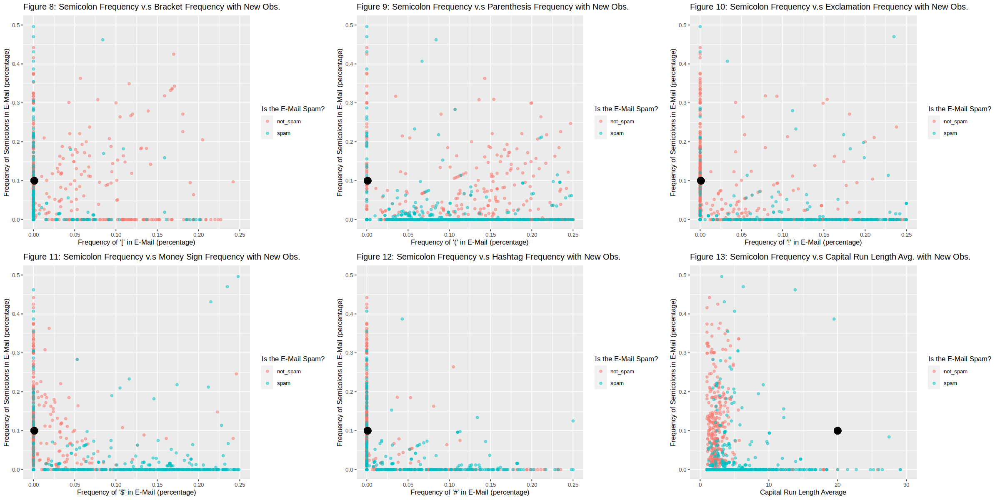

In [24]:
options(repr.plot.width = 20, repr.plot.height = 10)

spam_plot1 <- spam_training |>
    ggplot(aes(x = char_freq_brack, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    geom_point(aes(x = 0.001, y = 0.1),
              col = "black", 
              shape = 16, 
              size = 5) +
    labs(x = "Frequency of '[' in E-Mail (percentage)", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 0.25)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 8: Semicolon Frequency v.s Bracket Frequency with New Obs.")

spam_plot2 <- spam_training |>
    ggplot(aes(x = char_freq_paren, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    geom_point(aes(x = 0.001, y = 0.1),
              col = "black", 
              shape = 16, 
              size = 5) +
    labs(x = "Frequency of '(' in E-Mail (percentage)", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 0.25)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 9: Semicolon Frequency v.s Parenthesis Frequency with New Obs.")

spam_plot3 <- spam_training |>
    ggplot(aes(x = char_freq_excl, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    geom_point(aes(x = 0.001, y = 0.1),
              col = "black", 
              shape = 16, 
              size = 5) +
    labs(x = "Frequency of '!' in E-Mail (percentage)", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 0.25)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 10: Semicolon Frequency v.s Exclamation Frequency with New Obs.")

spam_plot4 <- spam_training |>
    ggplot(aes(x = char_freq_mon, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    geom_point(aes(x = 0.001, y = 0.1),
              col = "black", 
              shape = 16, 
              size = 5) +
    labs(x = "Frequency of '$' in E-Mail (percentage)", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 0.25)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 11: Semicolon Frequency v.s Money Sign Frequency with New Obs.")

spam_plot5 <- spam_training |>
    ggplot(aes(x = char_freq_hash, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    geom_point(aes(x = 0.001, y = 0.1),
              col = "black", 
              shape = 16, 
              size = 5) +
    labs(x = "Frequency of '#' in E-Mail (percentage)", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 0.25)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 12: Semicolon Frequency v.s Hashtag Frequency with New Obs.")

spam_plot6 <- spam_training |>
    ggplot(aes(x = capital_run_length_average, y = char_freq_semicolon, colour = spam_or_not_spam)) +
    geom_point(alpha = 0.5) +
    geom_point(aes(x = 20, y = 0.1),
              col = "black", 
              shape = 16, 
              size = 5) +
    labs(x = "Capital Run Length Average", y = "Frequency of Semicolons in E-Mail (percentage)", colour = "Is the E-Mail Spam?") +
    xlim(c(0, 30)) +
    ylim(c(0, 0.5)) +
    theme(text = element_text(size = 10)) +
    ggtitle("Figure 13: Semicolon Frequency v.s Capital Run Length Avg. with New Obs.")


suppressWarnings(plot_grid(spam_plot1, spam_plot2, spam_plot3, spam_plot4, spam_plot5, spam_plot6))

Through Figures 8, 12, 13, it is clear that the observation created was indeed likely to be a spam email, as the classifier predicted. However, figures such as Figures 9 and 10 may seem to tell us otherwise, or at least make it such that it is harder to predict whether or not the email was spam. So we see that there are some intricacies within the model, and these stem from our accuracy not being $100\%$. We will explore the cause of these intricacies further in the next section of this report. Notice that the $x$ value of the observation point in Figure 13 is different than the rest; this is due to the higher standard deviation and variance we saw earlier in our analysis, giving us the foresight to change this in our observation to limit biases. 

Word Count: 139 Words

## Discussion and Evaluation of Our Model

#### Summary of Findings

We found that our model that predicts whether an email is spam or not spam based on frequency of characters such as hard and soft brackets, semicolons, money symbols, exclamation points, and hash signs (all as percentages), as well as the average length of uninterrupted capital letters with 87% accuracy. This means that 87% of all predictions made were correct. Using a confusion matrix, we were able to determine that the precision of our model was 86.67%, meaning that 86.67% of emails that were not spam were correctly classified as not spam by our model. We found that our recall of the model was 92.56%. This means that 92.56% of the not spam emails were identified as not spam. 
Because our model focuses on 7 specific factors, these findings can only be applied to these 7 factors. At the beginning of our project, we cut out word frequency factors for simplicity. This potentially impacts the accuracy of the classifier, as the current model is biased toward character frequency. 
We implemented our model by using a new observation..........


#### Were the results expected?

This is what we expected to find. Our hypothesis was that emails that have a high frequency of brackets, semicolons, money symbols, etc. would be classified as spam while emails that have a more clean format will be classified as not spam. Our model found that these factors are 88% accurate at classifying whether an email is spam or not spam. 


#### Impacts of findings

These findings could allow spam sorting softwares to become more precise through further analysis of more factors. This could lead to less people being impacted by spam emails, such as eliminating viruses and information theft. 

#### What future questions does this lead to?

How can email sorting be optimized? Different k, different factors, k=8


### Total Word Count: 2000 Words 

 ## Works Cited

- [UCI Machine Learning Repo, Spambase Dataset, 1999]("https://archive.ics.uci.edu/dataset/94/spambase")
- [Forbes Article on Frequent Words in Spam Emails, 2010]("https://www.forbes.com/sites/firewall/2010/03/17/the-most-common-words-in-spam-email/?sh=5f23e8df7d80")
- [Virus Basics from CISA, 2023]("https://www.cisa.gov/news-events/news/virus-basics")